# Faster RCNN dengan Detectron2


# Install Detectron2 Dependencies

In [1]:
# install dependencies: (use cu101 because colab has CUDA 10.1)
!pip install -U torch==1.5 torchvision==0.6 -f https://download.pytorch.org/whl/cu101/torch_stable.html
!pip install cython pyyaml==5.1
!pip install -U 'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI'
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
!gcc --version
# opencv is pre-installed on colab

Looking in links: https://download.pytorch.org/whl/cu101/torch_stable.html
ERROR: Could not find a version that satisfies the requirement torch==1.5 (from versions: 1.11.0, 1.12.0, 1.12.1, 1.13.0, 1.13.1, 2.0.0, 2.0.1)
ERROR: No matching distribution found for torch==1.5
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 274.2/274.2 kB 5.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for pyyaml: filename=PyYAML-5.1-cp310-cp310-linux_x86_64.whl size=44091 sha256=3e03c61a74b2e68ca3e0b6746ccae31be6405b5a373d1ef19342e1bf98ca8a8a
  Stored in directory: /root/.cache/pip/wheels/70/83/31/975b737609aba39a4099d471d5684141c1fdc3404f97e7f68a
Successfully built pyyaml
  Attempting uninstall: pyyaml
    Found existing installation: PyYAML 6.0.1
    Uninstalling PyYAML-6.0.1:
      Successfully uninstalled PyYAML-6.0.1
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependen

In [2]:
# install detectron2:
!python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

  Cloning https://github.com/facebookresearch/detectron2.git to /tmp/pip-req-build-dhf896ik
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/detectron2.git /tmp/pip-req-build-dhf896ik
  Resolved https://github.com/facebookresearch/detectron2.git to commit 57bdb21249d5418c130d54e2ebdc94dda7a4c01a
  Preparing metadata (setup.py) ... done
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.2/50.2 kB 2.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.5/79.5 kB 5.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.5/154.5 kB 6.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 10.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.0/117.0 kB 11.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  

In [3]:
# You may need to restart your runtime prior to this, to let your installation take effect
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import cv2
import random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog
from detectron2.data.catalog import DatasetCatalog

# Import and Register Custom Detectron2 Data

In [4]:
!curl -L "https://app.roboflow.com/ds/JAeb9oBUrR?key=OKWlCEICSi" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   884  100   884    0     0   3104      0 --:--:-- --:--:-- --:--:--  3112
100  148M  100  148M    0     0  75.6M      0  0:00:01  0:00:01 --:--:--  105M
Archive:  roboflow.zip
 extracting: README.dataset.txt      
 extracting: README.roboflow.txt     
   creating: test/
 extracting: test/000000000061_jpg.rf.9a5801659c6ba895cd86fe4f01d0c5c8.jpg  
 extracting: test/000000000260_jpg.rf.5588845a45e0e46823334a66702c07c4.jpg  
 extracting: test/000000000360_jpg.rf.d85789782122a76dab5412125dcb5b42.jpg  
 extracting: test/000000000382_jpg.rf.759a63d32587fa26ab8846baf2869970.jpg  
 extracting: test/000000000389_jpg.rf.a2b27218919f34e666361d6250d67170.jpg  
 extracting: test/000000000446_jpg.rf.6492546bf3a63396ec908f8b2b6c6ec5.jpg  
 extracting: test/000000000544_jpg.rf.d89489f8dba31e264cf5b5f66cca9d02.jpg  
 extracting: test/000000000

In [5]:
from detectron2.data.datasets import register_coco_instances
register_coco_instances("my_dataset_train", {}, "/content/train/_annotations.coco.json", "/content/train")
register_coco_instances("my_dataset_val", {}, "/content/valid/_annotations.coco.json", "/content/valid")
register_coco_instances("my_dataset_test", {}, "/content/test/_annotations.coco.json", "/content/test")


WARNING [08/06 04:03:11 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[08/06 04:03:11 d2.data.datasets.coco]: Loaded 2450 images in COCO format from /content/train/_annotations.coco.json


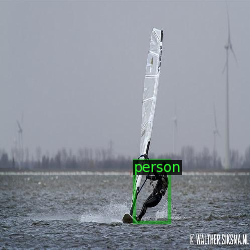

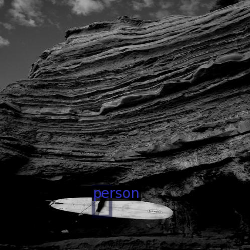

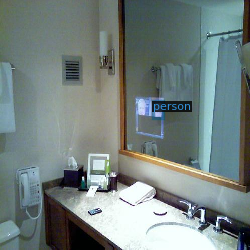

In [6]:
#visualize training data
my_dataset_train_metadata = MetadataCatalog.get("my_dataset_train")
dataset_dicts = DatasetCatalog.get("my_dataset_train")

import random
from detectron2.utils.visualizer import Visualizer

for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_train_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

# Train Custom Detectron2 Detector

In [7]:
#We are importing our own Trainer Module here to use the COCO validation evaluation during training. Otherwise no validation eval occurs.

from detectron2.engine import DefaultTrainer
from detectron2.evaluation import COCOEvaluator

class CocoTrainer(DefaultTrainer):

  @classmethod
  def build_evaluator(cls, cfg, dataset_name, output_folder=None):

    if output_folder is None:
        os.makedirs("coco_eval", exist_ok=True)
        output_folder = "coco_eval"

    return COCOEvaluator(dataset_name, cfg, False, output_folder)

In [8]:
#from .detectron2.tools.train_net import Trainer
#from detectron2.engine import DefaultTrainer
# select from modelzoo here: https://github.com/facebookresearch/detectron2/blob/master/MODEL_ZOO.md#coco-object-detection-baselines

from detectron2.config import get_cfg
#from detectron2.evaluation.coco_evaluation import COCOEvaluator
import os

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("my_dataset_train",)
cfg.DATASETS.TEST = ("my_dataset_val",)

cfg.DATALOADER.NUM_WORKERS = 4
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 4
cfg.SOLVER.BASE_LR = 0.001


cfg.SOLVER.WARMUP_ITERS = 1000
cfg.SOLVER.MAX_ITER = 2000 #adjust up if val mAP is still rising, adjust down if overfit
cfg.SOLVER.STEPS = (1000, 1999)
cfg.SOLVER.GAMMA = 0.05




cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 64
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 2 #your number of classes + 1

cfg.TEST.EVAL_PERIOD = 500


os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = CocoTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[08/06 04:03:18 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:560: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(
model_final_68b088.pkl: 421MB [00:03, 115MB/s]                            
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}


[08/06 04:03:23 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.10/dist-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[08/06 04:04:18 d2.utils.events]:  eta: 1:14:24  iter: 19  total_loss: 2.038  loss_cls: 1.009  loss_box_reg: 0.9169  loss_rpn_cls: 0.03375  loss_rpn_loc: 0.0339    time: 2.1983  last_time: 2.4107  data_time: 0.0456  last_data_time: 0.0281   lr: 1.931e-06  max_mem: 6858M
[08/06 04:05:11 d2.utils.events]:  eta: 1:18:10  iter: 39  total_loss: 1.999  loss_cls: 0.9961  loss_box_reg: 0.9085  loss_rpn_cls: 0.02127  loss_rpn_loc: 0.03454    time: 2.3370  last_time: 1.7768  data_time: 0.0259  last_data_time: 0.0247   lr: 2.911e-06  max_mem: 6858M
[08/06 04:05:59 d2.utils.events]:  eta: 1:17:22  iter: 59  total_loss: 1.972  loss_cls: 0.9804  loss_box_reg: 0.8909  loss_rpn_cls: 0.04293  loss_rpn_loc: 0.04335    time: 2.3527  last_time: 2.1466  data_time: 0.0227  last_data_time: 0.0303   lr: 3.891e-06  max_mem: 6858M
[08/06 04:06:45 d2.utils.events]:  eta: 1:15:55  iter: 79  total_loss: 1.929  loss_cls: 0.9547  loss_box_reg: 0.9131  loss_rpn_cls: 0.01416  loss_rpn_loc: 0.02226    time: 2.3470  las

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:560: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


[08/06 04:23:32 d2.evaluation.evaluator]: Inference done 11/700. Dataloading: 0.0021 s/iter. Inference: 0.1835 s/iter. Eval: 0.0005 s/iter. Total: 0.1861 s/iter. ETA=0:02:08
[08/06 04:23:37 d2.evaluation.evaluator]: Inference done 38/700. Dataloading: 0.0040 s/iter. Inference: 0.1820 s/iter. Eval: 0.0004 s/iter. Total: 0.1867 s/iter. ETA=0:02:03
[08/06 04:23:42 d2.evaluation.evaluator]: Inference done 66/700. Dataloading: 0.0033 s/iter. Inference: 0.1817 s/iter. Eval: 0.0004 s/iter. Total: 0.1855 s/iter. ETA=0:01:57
[08/06 04:23:47 d2.evaluation.evaluator]: Inference done 93/700. Dataloading: 0.0039 s/iter. Inference: 0.1818 s/iter. Eval: 0.0004 s/iter. Total: 0.1862 s/iter. ETA=0:01:53
[08/06 04:23:52 d2.evaluation.evaluator]: Inference done 120/700. Dataloading: 0.0038 s/iter. Inference: 0.1819 s/iter. Eval: 0.0004 s/iter. Total: 0.1862 s/iter. ETA=0:01:47
[08/06 04:23:58 d2.evaluation.evaluator]: Inference done 148/700. Dataloading: 0.0034 s/iter. Inference: 0.1819 s/iter. Eval: 0.0

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:560: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


[08/06 04:45:34 d2.evaluation.evaluator]: Inference done 11/700. Dataloading: 0.0012 s/iter. Inference: 0.1818 s/iter. Eval: 0.0003 s/iter. Total: 0.1833 s/iter. ETA=0:02:06
[08/06 04:45:40 d2.evaluation.evaluator]: Inference done 39/700. Dataloading: 0.0020 s/iter. Inference: 0.1817 s/iter. Eval: 0.0003 s/iter. Total: 0.1841 s/iter. ETA=0:02:01
[08/06 04:45:45 d2.evaluation.evaluator]: Inference done 66/700. Dataloading: 0.0038 s/iter. Inference: 0.1817 s/iter. Eval: 0.0004 s/iter. Total: 0.1860 s/iter. ETA=0:01:57
[08/06 04:45:50 d2.evaluation.evaluator]: Inference done 94/700. Dataloading: 0.0032 s/iter. Inference: 0.1819 s/iter. Eval: 0.0004 s/iter. Total: 0.1856 s/iter. ETA=0:01:52
[08/06 04:45:55 d2.evaluation.evaluator]: Inference done 122/700. Dataloading: 0.0029 s/iter. Inference: 0.1820 s/iter. Eval: 0.0004 s/iter. Total: 0.1854 s/iter. ETA=0:01:47
[08/06 04:46:00 d2.evaluation.evaluator]: Inference done 149/700. Dataloading: 0.0033 s/iter. Inference: 0.1821 s/iter. Eval: 0.0

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:560: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


[08/06 05:07:34 d2.evaluation.evaluator]: Inference done 11/700. Dataloading: 0.0011 s/iter. Inference: 0.1811 s/iter. Eval: 0.0003 s/iter. Total: 0.1825 s/iter. ETA=0:02:05
[08/06 05:07:39 d2.evaluation.evaluator]: Inference done 38/700. Dataloading: 0.0023 s/iter. Inference: 0.1820 s/iter. Eval: 0.0003 s/iter. Total: 0.1847 s/iter. ETA=0:02:02
[08/06 05:07:44 d2.evaluation.evaluator]: Inference done 65/700. Dataloading: 0.0029 s/iter. Inference: 0.1821 s/iter. Eval: 0.0003 s/iter. Total: 0.1856 s/iter. ETA=0:01:57
[08/06 05:07:49 d2.evaluation.evaluator]: Inference done 93/700. Dataloading: 0.0026 s/iter. Inference: 0.1820 s/iter. Eval: 0.0003 s/iter. Total: 0.1850 s/iter. ETA=0:01:52
[08/06 05:07:54 d2.evaluation.evaluator]: Inference done 120/700. Dataloading: 0.0033 s/iter. Inference: 0.1821 s/iter. Eval: 0.0003 s/iter. Total: 0.1859 s/iter. ETA=0:01:47
[08/06 05:07:59 d2.evaluation.evaluator]: Inference done 148/700. Dataloading: 0.0033 s/iter. Inference: 0.1820 s/iter. Eval: 0.0

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:560: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


[08/06 05:29:28 d2.evaluation.evaluator]: Inference done 11/700. Dataloading: 0.0011 s/iter. Inference: 0.1812 s/iter. Eval: 0.0003 s/iter. Total: 0.1826 s/iter. ETA=0:02:05
[08/06 05:29:33 d2.evaluation.evaluator]: Inference done 39/700. Dataloading: 0.0018 s/iter. Inference: 0.1817 s/iter. Eval: 0.0003 s/iter. Total: 0.1839 s/iter. ETA=0:02:01
[08/06 05:29:38 d2.evaluation.evaluator]: Inference done 66/700. Dataloading: 0.0021 s/iter. Inference: 0.1819 s/iter. Eval: 0.0003 s/iter. Total: 0.1845 s/iter. ETA=0:01:56
[08/06 05:29:44 d2.evaluation.evaluator]: Inference done 94/700. Dataloading: 0.0021 s/iter. Inference: 0.1817 s/iter. Eval: 0.0003 s/iter. Total: 0.1843 s/iter. ETA=0:01:51
[08/06 05:29:49 d2.evaluation.evaluator]: Inference done 121/700. Dataloading: 0.0021 s/iter. Inference: 0.1825 s/iter. Eval: 0.0003 s/iter. Total: 0.1851 s/iter. ETA=0:01:47
[08/06 05:29:54 d2.evaluation.evaluator]: Inference done 148/700. Dataloading: 0.0021 s/iter. Inference: 0.1825 s/iter. Eval: 0.0

In [9]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

In [10]:
#test evaluation
from detectron2.data import DatasetCatalog, MetadataCatalog, build_detection_test_loader
from detectron2.evaluation import COCOEvaluator, inference_on_dataset

cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.85
predictor = DefaultPredictor(cfg)
evaluator = COCOEvaluator("my_dataset_test", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "my_dataset_test")
inference_on_dataset(trainer.model, val_loader, evaluator)

[08/06 05:31:44 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...
WARNING [08/06 05:31:44 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
WARNING [08/06 05:31:44 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[08/06 05:31:44 d2.data.datasets.coco]: Loaded 350 images in COCO format from /content/test/_annotations.coco.json
[08/06 05:31:44 d2.data.build]: Distribution of instances among all 2 categories:
|  category  | #instances   |  category  | #instances   |
|:----------:|:-------------|:----------:|:-------------|
|   person   | 0            |   person   | 1461         |
|            |              |            |              |
|   total    | 1461         |            |              |
[08/06 05:31:44 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inferen

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:560: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


[08/06 05:31:47 d2.evaluation.evaluator]: Inference done 11/350. Dataloading: 0.0018 s/iter. Inference: 0.1839 s/iter. Eval: 0.0005 s/iter. Total: 0.1863 s/iter. ETA=0:01:03
[08/06 05:31:52 d2.evaluation.evaluator]: Inference done 39/350. Dataloading: 0.0023 s/iter. Inference: 0.1824 s/iter. Eval: 0.0004 s/iter. Total: 0.1852 s/iter. ETA=0:00:57
[08/06 05:31:57 d2.evaluation.evaluator]: Inference done 67/350. Dataloading: 0.0021 s/iter. Inference: 0.1813 s/iter. Eval: 0.0003 s/iter. Total: 0.1839 s/iter. ETA=0:00:52
[08/06 05:32:02 d2.evaluation.evaluator]: Inference done 95/350. Dataloading: 0.0025 s/iter. Inference: 0.1813 s/iter. Eval: 0.0004 s/iter. Total: 0.1842 s/iter. ETA=0:00:46
[08/06 05:32:07 d2.evaluation.evaluator]: Inference done 123/350. Dataloading: 0.0025 s/iter. Inference: 0.1811 s/iter. Eval: 0.0004 s/iter. Total: 0.1841 s/iter. ETA=0:00:41
[08/06 05:32:12 d2.evaluation.evaluator]: Inference done 151/350. Dataloading: 0.0024 s/iter. Inference: 0.1810 s/iter. Eval: 0.0

OrderedDict([('bbox',
              {'AP': 54.80301688093444,
               'AP50': 81.27943275526042,
               'AP75': 59.803264780775635,
               'APs': 23.322004648211912,
               'APm': 52.45462745510777,
               'APl': 72.01645130528873,
               'AP-person': 54.80301688093444})])

# Inference with Detectron2 Saved Weights



In [11]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.DATASETS.TEST = ("my_dataset_test", )
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7   # set the testing threshold for this model
predictor = DefaultPredictor(cfg)
test_metadata = MetadataCatalog.get("my_dataset_test")

[08/06 05:32:51 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...


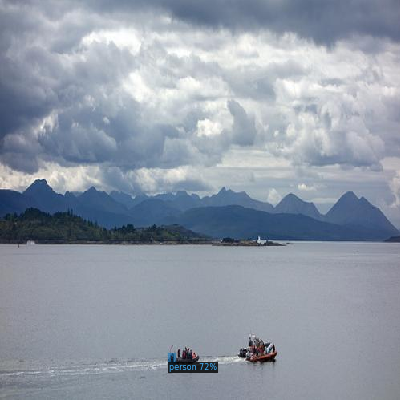

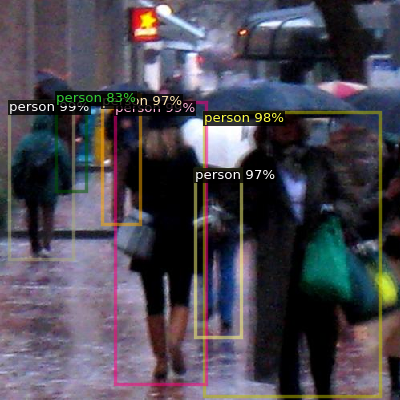

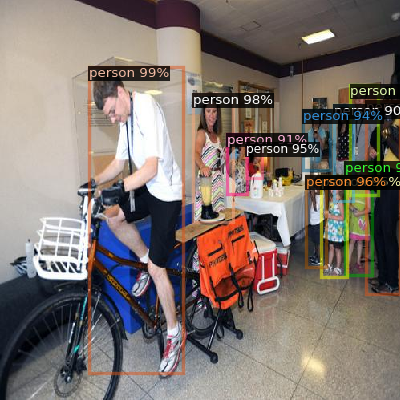

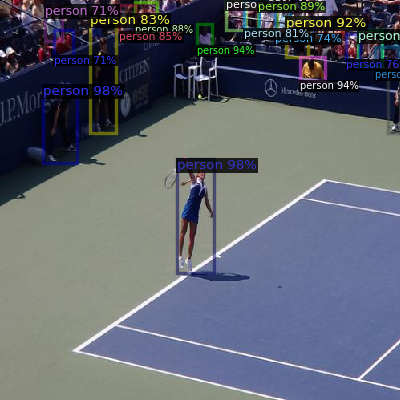

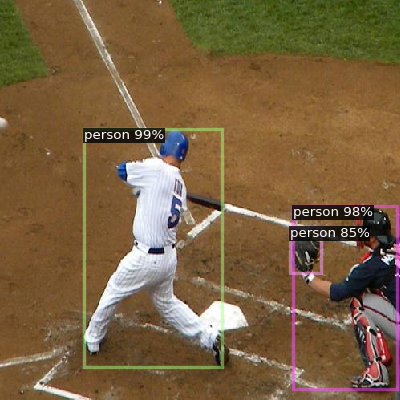

...

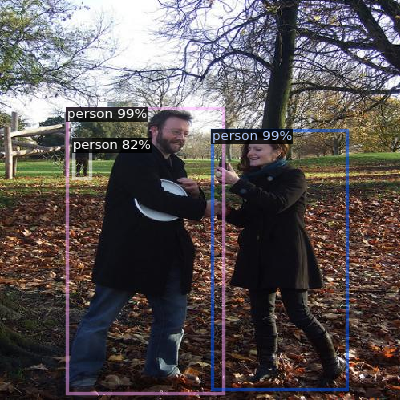

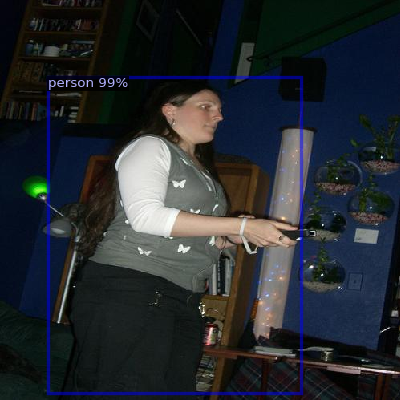

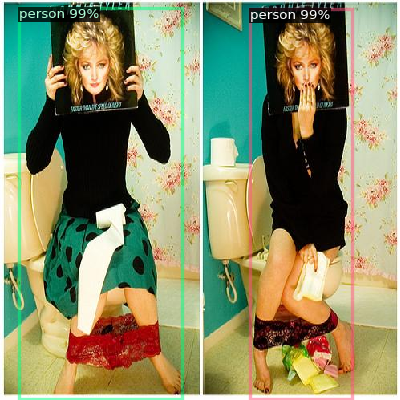

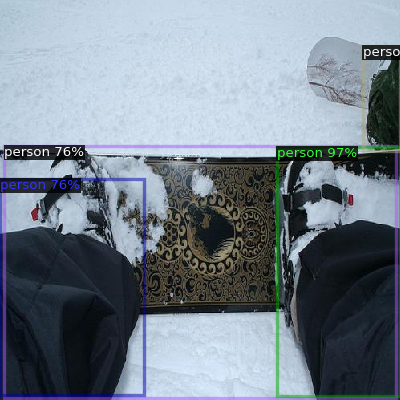

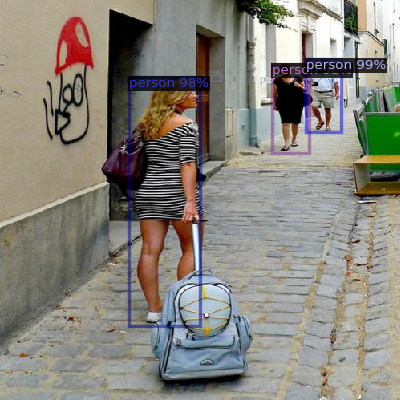

In [12]:
from detectron2.utils.visualizer import ColorMode
import glob

for imageName in glob.glob('/content/test/*jpg')[:50]:
  im = cv2.imread(imageName)
  outputs = predictor(im)
  v = Visualizer(im[:, :, ::-1],
                metadata=test_metadata,
                scale=0.8
                 )
  out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  cv2_imshow(out.get_image()[:, :, ::-1])
